In [1]:
import pandas as pd
from bifacial_peak_shaving import *
from utils import *
pd.options.plotting.backend='plotly'

# Data

In [2]:
dir = './Data/'

## Load

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 7982 entries, 2018-04-25 03:00:00 to 2019-03-23 16:00:00
Freq: H
Data columns (total 1 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Load (kW)  7982 non-null   float64
dtypes: float64(1)
memory usage: 124.7 KB
None


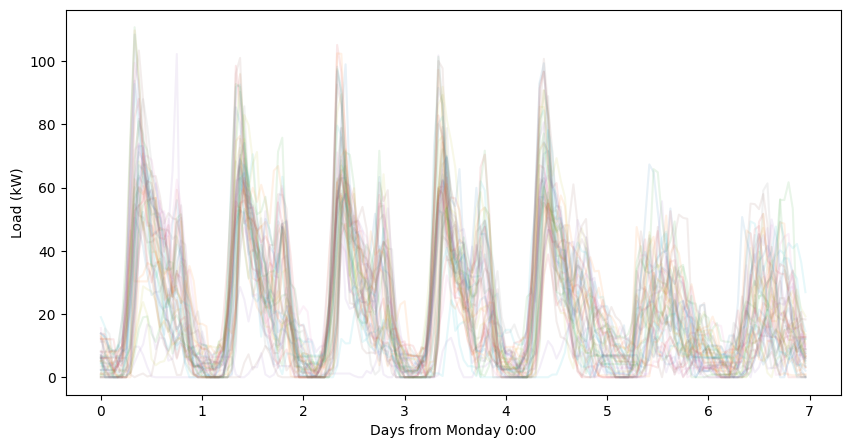

In [20]:
load = pd.read_csv('~/Data/EV/ACN Caltech/acn_caltech.csv',
                   index_col=0,
                   parse_dates=True,
                   comment='#',
                   )
                    #.resample('1h').mean()\
                    #.fillna(method='ffill')
                    #.loc['2018-4-26':'2019-3-22']
#load = pd.DataFrame({'Load (kW)':list(load.loc['2019-1-2 0:00':'2019-1-2 16:00','Load (kW)'])+list(load.loc[:,'Load (kW)'])},
#                     index=pd.date_range('2019-1-1 0:00',periods=8760,freq='1h'))
#load.loc['2019-5-20'] = load.loc['2019-5-22'].values
#load.loc['2019-5-21'] = load.loc['2019-5-22'].values
#load.index = pd.date_range('1901-1-1 0:00',periods=35040,freq='15min')
load = load.fillna(method='ffill')
load = load.resample('1h').mean()
print(load.info())
plot_weekly(load['Load (kW)'])
load.plot()

## Solar

- 7 kWp, TMY

- Net zero capacity

  - $capacity[kWp] = production[kWh] \times yield [\frac{kWh}{kWp}]^{-1}$

In [26]:
solar_angles = ['s20','w90']

s20 = pd.concat((pd.read_csv('~/Data/Solar/Modelled/pasadena_2018_1h_367mods_s20.csv',index_col=0,parse_dates=True),
                 pd.read_csv('~/Data/Solar/Modelled/pasadena_2019_1h_367mods_s20.csv',index_col=0,parse_dates=True)))

w90 = pd.concat((pd.read_csv('~/Data/Solar/Modelled/pasadena_2018_1h_367mods_w90.csv',index_col=0,parse_dates=True),
                 pd.read_csv('~/Data/Solar/Modelled/pasadena_2019_1h_367mods_w90.csv',index_col=0,parse_dates=True)))

solar = pd.concat((s20,w90),axis=1)
solar.columns=solar_angles

solar = solar.loc[load.index]

net_zero_capacity = load['Load (kW)'].sum() / (solar.s20.sum()/7) # load=production / yield
solar = solar * net_zero_capacity/7 # scale to net 0
solar.describe()

,s20,w90
count,7982.000000,7982.000000
mean,20.561530,17.635150
std,28.521521,23.302947
min,-0.037044,-0.031437
25%,-0.008008,-0.008008
50%,-0.008008,-0.008008
75%,43.110789,35.327161
max,107.434970,87.674085


In [4]:
# solar_angles = ['s20','w20','w90','s20w90']
# solar = pd.concat(( 
#                     pd.read_csv(dir+'Solar/Modelled/lemooreCA_7kwp_s20deg.csv',index_col=0),
#                     pd.read_csv(dir+'Solar/Modelled/lemooreCA_7kwp_w20deg.csv',index_col=0),
#                     pd.read_csv(dir+'Solar/Modelled/lemooreCA_7kwp_w90deg.csv',index_col=0),
#                     pd.read_csv(dir+'Solar/Modelled/lemooreCA_3.5kwp_s20deg_3.5kwp_w90deg.csv',index_col=0),
#                    ),
#                   axis=1)
# solar.index = pd.date_range('1900-1-1 0:00',periods=8760,freq='1h')
# solar.columns = solar_angles
# net_zero_capacity = load['Load (kW)'].sum() / (solar.s20.sum()/7) # load=production / yield
# solar = solar * net_zero_capacity/7 # scale to net 0
# solar.describe()

,s20,w20,w90,s20w90
count,8760.000000,8760.000000,8760.000000,8760.000000
mean,19.913887,17.801734,19.045143,19.495684
std,28.116124,25.125326,25.036433,24.828871
min,-0.069281,-0.069281,-0.063140,-0.057946
25%,-0.008196,-0.008196,-0.008196,-0.008196
50%,-0.008196,-0.008196,-0.008196,-0.008196
75%,39.375306,34.899477,36.681002,42.021706
max,113.619475,109.463243,95.927687,88.275993


In [5]:
# solar = solar/7
# solar[['s20']].to_csv('/home/mjw/Downloads/lemoore_solar_s20_1kwp_TMY_1h.csv')

In [6]:
# for col in solar:
#     plot_daily(solar[col],title=col,interval_min=60)

## Net load

In [27]:
solar.index = load.index
df = pd.concat((load,solar),axis=1)
df.columns = ['load'] + ['solar_'+x for x in solar.columns]
for angle in solar.columns:
    df[f'netload_{angle}'] = df['load'] - solar[angle]
df    

,load,solar_s20,solar_w90,netload_s20,netload_w90
Datetime (PST),,,,,
2018-04-25 03:00:00,2.204989,-0.008008,-0.008008,2.212996,2.212996
2018-04-25 04:00:00,3.575657,-0.008008,-0.008008,3.583665,3.583665
2018-04-25 05:00:00,2.320463,-0.008008,0.329419,2.328471,1.991044
2018-04-25 06:00:00,10.338417,10.972227,30.715948,-0.633810,-20.377531
2018-04-25 07:00:00,33.517996,37.382843,69.945093,-3.864846,-36.427096
...,...,...,...,...,...
2019-03-23 12:00:00,12.465856,79.087192,29.735401,-66.621336,-17.269546
2019-03-23 13:00:00,13.101229,62.429137,37.822913,-49.327908,-24.721684
2019-03-23 14:00:00,5.963329,30.118714,24.142145,-24.155385,-18.178816


load v s20

In [8]:
# l = df['load']
# s = df['solar_s20']
# avg_monthly_max = (l - s).resample('1M').max().mean()  
# plot_weekly((l,s),f'Avg monthly max kW: {avg_monthly_max:.1f}',ylabel='kW')

In [9]:
# l = df['load']
# s = df['solar_s20']
# avg_monthly_max = (l - s).resample('1M').max().mean()  
# plot_weekly(l-s,f'Avg monthly max kW: {avg_monthly_max:.1f}',ylabel='kW')

load v w20

In [10]:
# l = df['load']
# s = df['solar_w20']
# avg_monthly_max = (l - s).resample('1M').max().mean()  
# plot_weekly((l,s),f'Avg monthly max kW: {avg_monthly_max:.1f}',ylabel='kW')

In [11]:
# l = df['load']
# s = df['solar_w20']
# avg_monthly_max = (l - s).resample('1M').max().mean()  
# plot_weekly(l-s,f'Avg monthly max kW: {avg_monthly_max:.1f}',ylabel='kW')

load v w90

In [12]:
# l = df['load']
# s = df['solar_w90']
# avg_monthly_max = (l - s).resample('1M').max().mean()  
# plot_weekly((l,s),f'Avg monthly max kW: {avg_monthly_max:.1f}',ylabel='kW')

In [13]:
# l = df['load']
# s = df['solar_w90']
# avg_monthly_max = (l - s).resample('1M').max().mean()  
# plot_weekly(l-s,f'Avg monthly max kW: {avg_monthly_max:.1f}',ylabel='kW')

load v s20w90

In [14]:
# l = df['load']
# s = df['solar_s20w90']
# avg_monthly_max = (l - s).resample('1M').max().mean()  
# plot_weekly((l,s),f'Avg monthly max kW: {avg_monthly_max:.1f}',ylabel='kW')

In [15]:
# l = df['load']
# s = df['solar_s20w90']
# avg_monthly_max = (l - s).resample('1M').max().mean()  
# plot_weekly(l-s,f'Avg monthly max kW: {avg_monthly_max:.1f}',ylabel='kW')

# Baseline costs

Load only, and net load given various solar

In [28]:
TOU = [{'price':26.07,      'hours':list(range(24)) },
       {'price': 6.81,      'hours':list(range(14,16))+list(range(21,23))},
       {'price':32.90,      'hours':list(range(16,21))}]

In [29]:
all_cost = {}

cost = 0
for year in df.index.year.unique():
    df_year = df[df.index.year==year]
    for month in df_year.index.month.unique():
        df_month = df_year[df_year.index.month==month]
        cost += calc_power_cost(df_month['load'],TOU)
        all_cost['load'] = round(cost,0)

for angle in solar_angles:
    cost = 0
    for year in df.index.year.unique():
        df_year = df[df.index.year==year]
        for month in df_year.index.month.unique():
            df_month = df_year[df_year.index.month==month]
            cost += calc_power_cost(df_month[f'netload_{angle}'],TOU)
    all_cost[angle] = round(cost,0)
all_cost

{'load': 50421.0, 's20': 40590.0, 'w90': 40955.0}

# Monthly peaks

## Single TOU

In [18]:
# peak_begin,peak_end = 8,11
# angle = 's20'
# peaks = calc_monthly_peaks(df[f'netload_{angle}'],peak_begin,peak_end)

# angle = 'w20'
# peaks = pd.concat((peaks,calc_monthly_peaks(df[f'netload_{angle}'],peak_begin,peak_end)),axis=1)
# peaks[f'netload_s20->{angle} reduc kw'] = peaks['netload_s20 kw'] - peaks[f'netload_{angle} kw']

# angle = 'w90'
# peaks = pd.concat((peaks,calc_monthly_peaks(df[f'netload_{angle}'],peak_begin,peak_end)),axis=1)
# peaks[f'netload_s20->{angle} reduc kw'] = peaks['netload_s20 kw'] - peaks[f'netload_{angle} kw']

# angle = 's20w90'
# peaks = pd.concat((peaks,calc_monthly_peaks(df[f'netload_{angle}'],peak_begin,peak_end)),axis=1)
# peaks[f'netload_s20->{angle} reduc kw'] = peaks['netload_s20 kw'] - peaks[f'netload_{angle} kw']

# print('Avg w20 reduction',peaks['netload_s20->w20 reduc kw'].mean())
# print('Avg w90 reduction',peaks['netload_s20->w90 reduc kw'].mean())
# print('Avg s20w90 reduction',peaks['netload_s20->s20w90 reduc kw'].mean())
# peaks

## Variable TOU

w20

In [19]:
# angle1 = 's20'
# angle2 = 'w20'

# peak_reduc_v_TOU = net_load_peak_reduction_variable_TOU(df,angle1,angle2)
# peak_reduc_v_TOU[peak_reduc_v_TOU['avg peak reduction [kW]']>0.1]

w90

In [20]:
# angle1 = 's20'
# angle2 = 'w90'

# peak_reduc_v_TOU = net_load_peak_reduction_variable_TOU(df,angle1,angle2)
# peak_reduc_v_TOU[peak_reduc_v_TOU['avg peak reduction [kW]']>0.1]

s20w90

In [21]:
# angle1 = 's20'
# angle2 = 's20w90'

# peak_reduc_v_TOU = net_load_peak_reduction_variable_TOU(df,angle1,angle2)
# peak_reduc_v_TOU[peak_reduc_v_TOU['avg peak reduction [kW]']>0.1]

Best for w90

In [22]:
#df.loc['2022-6-28':'2022-6-30'][['load','solar_s20','solar_w90','solar_s20w90']].plot()

In [23]:
#df.loc['2022-3-5':'2022-3-7'][['load','solar_s20','solar_w90','solar_s20w90']].plot()

Largest spread w90 v s20w90

In [24]:
#df.loc['2022-10-12':'2022-10-14'][['load','solar_s20','solar_w90','solar_s20w90']].plot()

# Peak shaving

## Basic

In [33]:
angle = 's20'
thresholds = (20,20,20)
batt_kwh = 100
TOU = [{'price':26.07,      'hours':list(range(24)) },
       {'price':    0,      'hours':list(range(24))},
       {'price':    0,      'hours':list(range(24))} ]

fail,dispatch = peak_shaving_sim(   df[['load',f'solar_{angle}',f'netload_{angle}']][:24*31],
                                    f'netload_{angle}',
                                    batt_kwh,
                                    thresholds,
                                    TOU,
                                    utility_chg_max=batt_kwh,)

plotly_stacked( dispatch,
                solar=f'solar_{angle}',
                threshold0=thresholds[0], threshold0_h=TOU[0]['hours'],                     
                threshold1=thresholds[1], threshold1_h=TOU[1]['hours'],
                threshold2=thresholds[2], threshold2_h=TOU[2]['hours'],                                
                title={True:'SOE Failure',False:''}[fail],
                size=(800,400),
                upsample_min=1)

## Multi-TOU

In [34]:
angle = 's20'
thresholds = (25.977,22.293,0.0)
batt_kwh = 200
TOU = [{'price':26.07,      'hours':list(range(24)) },
       {'price': 6.81,      'hours':list(range(14,16))+list(range(21,23))},
       {'price':32.90,      'hours':list(range(16,21))}]


fail,dispatch = peak_shaving_sim(  df[['load',f'solar_{angle}',f'netload_{angle}']][:(24*31)],
                                          f'netload_{angle}',
                                          batt_kwh,
                                          thresholds,
                                          TOU,
                                          utility_chg_max=batt_kwh,)
cost = calc_power_cost(dispatch.utility,TOU)

plotly_stacked( dispatch,
                solar=f'solar_{angle}',
                threshold0=thresholds[0], threshold0_h=TOU[0]['hours'],                     
                threshold1=thresholds[1], threshold1_h=TOU[1]['hours'],
                threshold2=thresholds[2], threshold2_h=TOU[2]['hours'],                                
                title=f'Cost {cost:.1f} ' + {True:'SOE Failure',False:''}[fail],
                size=(800,400),
                upsample_min=1)

## New multi-TOU

Grid search rough, fine, and gradient descent

In [49]:
import numpy as np

def f(thresholds):
    th0,th1,th2 = thresholds
    fail,dispatch = peak_shaving_sim(   df_month,
                                    f'netload_{angle}',
                                    batt_kwh,
                                    [th0,th1,th2],
                                    TOU,
                                    utility_chg_max=batt_kwh,)                
    cost = calc_power_cost(dispatch.utility,TOU)
    return cost,fail,dispatch

def grad_f(th_i):
    #c,fail,_ = f(th_i)
    
    d = 0.05
    
    c0_0,fail,_ = f([x+dx for x,dx in zip(th_i,[-d,0,0])])
    if fail == True: c0_0,fail,_ = f(th_i)
    c0_1,fail,_ = f([x+dx for x,dx in zip(th_i,[d,0,0])])
    if fail == True: c0_1,fail,_ = f(th_i)
    
    
    c1_0,fail,_ = f([x+dx for x,dx in zip(th_i,[0,-d,0])])
    if fail == True: c1_0,fail,_ = f(th_i)
    c1_1,fail,_ = f([x+dx for x,dx in zip(th_i,[0,d,0])])
    if fail == True: c1_1,fail,_ = f(th_i)
    
    
    c2_0,fail,_ = f([x+dx for x,dx in zip(th_i,[0,0,-d])])
    if fail == True: c2_0,fail,_ = f(th_i)
    c2_1,fail,_ = f([x+dx for x,dx in zip(th_i,[0,0,d])])
    if fail == True: c2_1,fail,_ = f(th_i)

    
    return (c0_0-c0_1,c1_0-c1_1,c2_0-c2_1)

TOU = [{'price':26.07,      'hours':list(range(24)) },
       {'price': 6.81,      'hours':list(range(14,16))+list(range(21,23))},
       {'price':32.90,      'hours':list(range(16,21))}]

rough_search_max = 100
rough_step = 10

tic = pd.Timestamp.now()

output_filename = 'caltech_ev_mjw4__output__'+tic.strftime('%y-%m-%d %H-%M-%S')+'.csv'
output = pd.DataFrame([],columns=['angle','batt kwh','total cost','jan'])#,'feb','mar','apr','may','jun','jul','aug','sep','oct','nov','dec'])
for angle in ['s20']:#,'s20, w20','w90','s20w90']:
    for batt_kwh in [200]:#[200,300,400,500,600,700,800,900,1000]:
        best_monthly = pd.DataFrame([],columns=['year-month','threshold0','threshold1','threshold2','cost'])
        for year in df.index.year.unique()[:1]:
            df_year = df[df.index.year==year]
            for month in df_year.index.month.unique()[:1]:
                print(f'{pd.Timestamp.now()} Angle {angle} batt_kwh {batt_kwh } begin new month {year}-{month}')
                df_month = df_year[df_year.index.month==month][['load',f'solar_{angle}',f'netload_{angle}']]
                r = pd.DataFrame([], columns=['i','fail','th0','th1','th2','c','deltac','dc'])
                k = 0
                for th0 in range(0,rough_search_max,rough_step):
                    for th1 in range(0,rough_search_max,rough_step):
                        for th2 in range(0,rough_search_max,rough_step):
                            k += 1
                            fail,dispatch = peak_shaving_sim(   df_month,
                                                                f'netload_{angle}',
                                                                batt_kwh,
                                                                [th0,th1,th2],
                                                                TOU,
                                                                utility_chg_max=batt_kwh,)                
                            #if fail == False:
                            cost = calc_power_cost(dispatch.utility,TOU)
                            r.loc[len(r)] = [k,fail,th0,th1,th2,cost,pd.NA,pd.NA]
                
                if len(r) > 0:
                    best_cost = r[r.fail==False]['c'].min()
                    imin = r[r.fail==False]['c'].idxmin()
                    best_th0 = r.loc[imin].th0
                    best_th1 = r.loc[imin].th1
                    best_th2 = r.loc[imin].th2
                else: 
                    print(f'\n\n\n /// No viable solutions angle {angle} batt_kwh {batt_kwh} year-month {year}-{month} rough_search_max {rough_search_max}/// \n\n\n')
                    break
                
                print(f'{pd.Timestamp.now()} Rough grid search done for {year}-{month} thresholds=({best_th0:.1f},{best_th1:.1f},{best_th2:.1f}), cost={best_cost:.1f} ')
                
                for th0 in range(max(0,int(best_th0-rough_step)),int(best_th0+rough_step)):
                    for th1 in range(max(0,int(best_th1-rough_step)),int(best_th1+rough_step)):
                        for th2 in range(max(0,int(best_th2-rough_step)),int(best_th2+rough_step)):                        
                            k += 1
                            fail,dispatch = peak_shaving_sim(   df_month,
                                                                f'netload_{angle}',
                                                                batt_kwh,
                                                                [th0,th1,th2],
                                                                TOU,
                                                                utility_chg_max=batt_kwh,)                
                            #if fail == False:
                            cost = calc_power_cost(dispatch.utility,TOU)
                            r.loc[len(r)] = [k,fail,th0,th1,th2,cost,pd.NA,pd.NA]
                
                best_cost = r[r.fail==False]['c'].min()
                imin = r[r.fail==False]['c'].idxmin()
                best_th0 = r.loc[imin].th0
                best_th1 = r.loc[imin].th1
                best_th2 = r.loc[imin].th2
                
                print(f'{pd.Timestamp.now()} Fine grid search done for {year}-{month} thresholds=({best_th0:.1f},{best_th1:.1f},{best_th2:.1f}), cost={best_cost:.1f} ')
                
                LR = (0.1,0.1,0.1)
                
                c = []
                th = [[best_th0,best_th1,best_th2]]
                cost,fail,dispatch = f(th[0])
                c.append(cost)
                
                final_countdown = 20
                for i in range(1,500):
                    dc = grad_f(th[i-1])
                    dth = [(dx+nz)*lr for dx,lr,nz in zip(dc,LR,np.random.rand(3))]
                    new_th = [max(0,x+dx) for x,dx in zip(th[i-1],dth)]
                    th.append(new_th)
                    cost,fail,dispatch = f(th[i])                    
                    c.append(cost)
                    
                    r.loc[len(r)] = [i+k,
                                    fail,
                                    round(th[i][0],3),
                                    round(th[i][1],3),
                                    round(th[i][2],3),
                                    c[i],
                                    c[i]-c[i-1],
                                    [round(x,3) for x in dc]]
                    

                    # stopping conditions
                    
                    if r[['deltac']][k:].dropna().rolling(100).std().iloc[-1,0] > 10:
                        break
                    
                    # deltac = r[['deltac']].rolling(100).mean()[k:].dropna()
                    # if len(deltac[deltac.deltac > -0.1]) >= 50:
                    #     break
                    
                    # if abs(c[i]-c[i-1])<0.3:
                    #     final_countdown -= 1
                        
                    # if final_countdown == 0:
                    #     break
                
                # LR = (0.01,0.01,0.01)
                
                # j = i
                # for i in range(j,j+500):
                #     dc = grad_f(th[i-1])
                #     dth = [(dx+nz)*lr for dx,lr,nz in zip(dc,LR,rnd.rand(3))]
                #     new_th = [max(0,x+dx) for x,dx in zip(th[i-1],dth)]
                #     th.append(new_th)
                #     cost,fail,dispatch = f(th[i])                    
                #     c.append(cost)
                    
                #     r.loc[len(r)] = [i+k,
                #                      fail,
                #                      round(th[i][0],3),
                #                      round(th[i][1],3),
                #                      round(th[i][2],3),
                #                      c[i],
                #                      c[i]-c[i-1],
                #                      [round(x,3) for x in dc]]


                best_cost = r[r.fail==False]['c'].min()
                imin = r[r.fail==False]['c'].idxmin()
                best_th0 = r.loc[imin].th0
                best_th1 = r.loc[imin].th1
                best_th2 = r.loc[imin].th2
                best_monthly.loc[len(best_monthly)] = [f'{year}-{month}',
                                                    best_th0,
                                                    best_th1,
                                                    best_th2,
                                                    best_cost]
            
                print(f'{pd.Timestamp.now()} Gradient descent done for {year}-{month} thresholds=({best_th0:.1f},{best_th1:.1f},{best_th2:.1f}), cost={best_cost:.1f} ')
        
        #best_monthly.index = best_monthly.month
        #best_monthly = best_monthly.drop(columns=['month'])
        
        # print('/// Best monthly')
        # print(f'Batt kwh {batt_kwh}')
        # print(f'Total cost {best_monthly.cost.sum():.1f}')
        # print(best_monthly.T,'\n\n')
        
        
        new_row = [angle, batt_kwh, best_monthly.cost.sum()]
        for th0,th1,th2 in zip(best_monthly.threshold0,best_monthly.threshold1,best_monthly.threshold2):
            new_row.append( (th0,th1,th2) )
        output.loc[len(output)] = new_row
        #output.to_csv(output_filename)
        
# r.loc[r.fail==False,'c'] = r[r.fail==False].c
# r.loc[r.fail==True,'c (fail)'] = r[r.fail==True].c
# r[['c','c (fail)']].plot()
print('Elapsed',pd.Timestamp.now()-tic)

2023-07-30 23:08:46.531609 Angle s20 batt_kwh 200 begin new month 2018-4
2023-07-30 23:08:53.560468 Rough grid search done for 2018-4 thresholds=(10.0,0.0,0.0), cost=260.7 
2023-07-30 23:09:08.006473 Fine grid search done for 2018-4 thresholds=(1.0,0.0,0.0), cost=26.1 
2023-07-30 23:09:12.406547 Gradient descent done for 2018-4 thresholds=(0.4,2.6,0.0), cost=13.3 
Elapsed 0 days 00:00:25.883576


In [48]:
output

,angle,batt kwh,total cost,jan


In [28]:
r[['deltac']][k:].dropna().rolling(100).std().plot()

In [29]:
r[r.fail==False].loc[k+1:].plot.scatter(x='th0',y='c',color='i',width=800,height=400)

In [30]:
r[r.fail==False].loc[k+1:].plot.scatter(x='th1',y='c',color='i',width=800,height=400)

In [31]:
r[r.fail==False].loc[k+1:].plot.scatter(x='th2',y='c',color='i',width=800,height=400)

In [32]:
r.loc[k+1:][['th0','th1','c']].plot.scatter(x='th0',y='th1',color='c')

In [33]:
r.loc[k+1:][['th0','th2','c']].plot.scatter(x='th0',y='th2',color='c')

In [34]:
import plotly.express as px

fig = px.scatter_3d(r.loc[k+1:], x='th0', y='th1', z='th2',
              color='c')
fig.show()